<a href="https://colab.research.google.com/github/bananighosh/ai-SAM-remote-sensing-satellite-imagery/blob/main/notebook/bg2502_satellite.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Segment Anything Model for Geospatial Data

[![image](https://studiolab.sagemaker.aws/studiolab.svg)](https://studiolab.sagemaker.aws/import/github/opengeos/segment-geospatial/blob/main/docs/examples/satellite.ipynb)
[![image](https://img.shields.io/badge/Open-Planetary%20Computer-black?style=flat&logo=microsoft)](https://pccompute.westeurope.cloudapp.azure.com/compute/hub/user-redirect/git-pull?repo=https://github.com/opengeos/segment-geospatial&urlpath=lab/tree/segment-geospatial/docs/examples/satellite.ipynb&branch=main)
[![image](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/opengeos/segment-geospatial/blob/main/docs/examples/satellite.ipynb)

This notebook shows how to use segment satellite imagery using the Segment Anything Model (SAM) with a few lines of code.

Make sure you use GPU runtime for this notebook. For Google Colab, go to `Runtime` -> `Change runtime type` and select `GPU` as the hardware accelerator.

## Install dependencies

Uncomment and run the following cell to install the required dependencies.


In [18]:
%pip install patchify

In [1]:
%pip install segment-geospatial

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.2/52.2 kB 1.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 30.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 56.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 96.0/96.0 kB 11.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.5/21.5 MB 28.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.0/53.0 kB 3.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.2/40.2 kB 3.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 18.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 108.6/108.6 kB 11.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.8/2.8 MB 44.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 263.1/263.1 kB 16.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.8/52.8 kB 6.1 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_c

## Import libraries

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import os
import leafmap
from samgeo import SamGeo, tms_to_geotiff, get_basemaps
from patchify import patchify  #Only to handle large images
import random
from scipy import ndimage

## Create an interactive map

lane detection  - line fitting?? - cv2 library

- apply probabilistic reasoning - using kinematic state plot the trajectory under the tree for the sidewalk - similar to the drone trajectory

- GIS type of vector data - study on this
- every point we detect has to be localised
- geoparquet datafile - no. 1 data format across the whole  - hugging face comp vision datasets - checkout
- raster images given to us is very very large , 1 pixel = 1sqft, need higher resolution imagery. -> 30cm satellite imagery (considered as super high imagery), neural net cannot process 5000x 5000 imagery so we use chips of 256 x 256 pixel imagery and corresponding masks used for training and supervised learning

- Professor to share the pdf (confidential) - do not upload anywhere.



In [41]:
# m = leafmap.Map(center=[29.676840, -95.369222], zoom=19)

# map of New Jersey
m = leafmap.Map(center=[40.7434679,-74.175889], zoom = 19)
m.add_basemap("SATELLITE")
m

Map(center=[40.7434679, -74.175889], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title…

In [43]:
# Draw polygon to specify ROI before this step
image = "satellite.tif"
m.user_roi_bounds()
if m.user_roi_bounds() is not None:
    bbox = m.user_roi_bounds()
else:
    bbox = [40.7443562,-74.1787129, 40.7426791,-74.1753179] # [-95.3704, 29.6762, -95.368, 29.6775]
tms_to_geotiff(output=image, bbox=bbox, zoom=20, source="Satellite", overwrite=True)

#165 large images as tiff image stack
large_images = tifffile.imread(image)
print(large_images.shape)

Downloaded image 01/50
Downloaded image 02/50
Downloaded image 03/50
Downloaded image 04/50
Downloaded image 05/50
Downloaded image 06/50
Downloaded image 07/50
Downloaded image 08/50
Downloaded image 09/50
Downloaded image 10/50
Downloaded image 11/50
Downloaded image 12/50
Downloaded image 13/50
Downloaded image 14/50
Downloaded image 15/50
Downloaded image 16/50
Downloaded image 17/50
Downloaded image 18/50
Downloaded image 19/50
Downloaded image 20/50
Downloaded image 21/50
Downloaded image 22/50
Downloaded image 23/50
Downloaded image 24/50
Downloaded image 25/50
Downloaded image 26/50
Downloaded image 27/50
Downloaded image 28/50
Downloaded image 29/50
Downloaded image 30/50
Downloaded image 31/50
Downloaded image 32/50
Downloaded image 33/50
Downloaded image 34/50
Downloaded image 35/50
Downloaded image 36/50
Downloaded image 37/50
Downloaded image 38/50
Downloaded image 39/50
Downloaded image 40/50
Downloaded image 41/50
Downloaded image 42/50
Downloaded image 43/50
Downloaded 

Pan and zoom the map to select the area of interest. Use the draw tools to draw a polygon or rectangle on the map

In [45]:
image = "satellite.tif"
m.layers[-1].visible = False  # turn off the basemap
m.add_raster(image, layer_name="Image")
m

Map(bottom=50448509.0, center=[40.743449999999996, -74.17585], controls=(ZoomControl(options=['position', 'zoo…

In [46]:
sam = SamGeo(
    model_type="vit_h",
    sam_kwargs=None,
)
sam.generate(image, output="ag_masks.tif", foreground=True, unique=True)

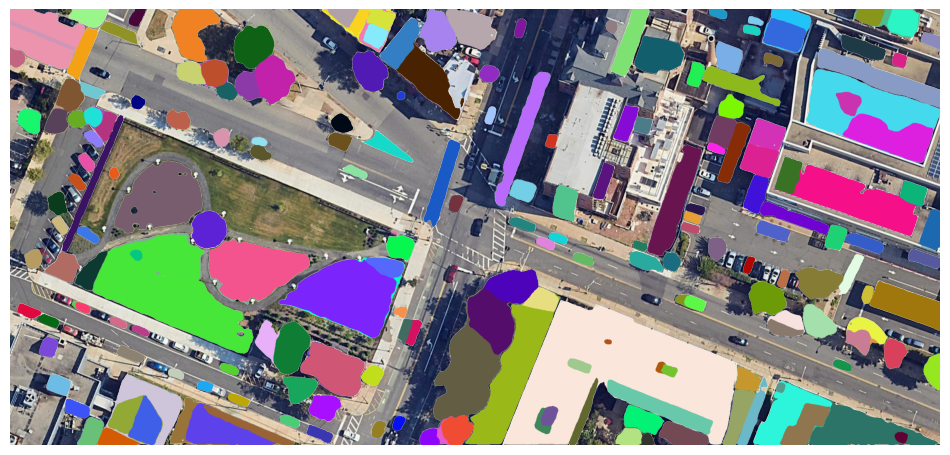

In [47]:
# sam.show_masks(cmap="binary_r")
sam.show_anns(axis="off", alpha=1, output="ag_annotations.tif")

## MINE

In [5]:
m = leafmap.Map(center=[40.7434679,-74.175889], zoom=19)
style = {
    "color": "#000000",
    "weight": 2,
    "fillColor": "#7c4185",
    "fillOpacity": 0.5,
}

# *Download tif image file*
leafmap.download_file(
    url="https://github.com/opengeos/data/blob/main/naip/agriculture.tif",
    quiet=True,
    overwrite=True,
)

# Display the downloaded image on the map.
image = '/content/satellite.tif'
m.layers[-1].visible = False  # turn off the basemap
m.add_raster(image, layer_name="Image")

# Initialize SAM
sam = SamGeo(
    model_type="vit_h",
    checkpoint="sam_vit_h_4b8939.pth",
    sam_kwargs=None,
)

# Segment the image
mask = "segment.tif"
sam.generate(
    image, output=mask, batch=True, foreground=True, erosion_kernel=(3, 3), mask_multiplier=255
)

# Save the segmentation results as a GeoPackage file.
vector = "segment.gpkg"
sam.tiff_to_gpkg(mask, output=vector, simplify_tolerance=None)

m.add_vector(vector, layer_name="Vector", style=style)
m

100%|██████████| 15/15 [02:00<00:00,  8.06s/it]


Map(center=[40.7434679, -74.175889], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title…

In [6]:
m.layers[-1].visible = True
m.add_vector(vector, layer_name="Vector", style=style)
m

Map(bottom=100896809.0, center=[40.74335863610756, -74.17633404774455], controls=(ZoomControl(options=['positi…

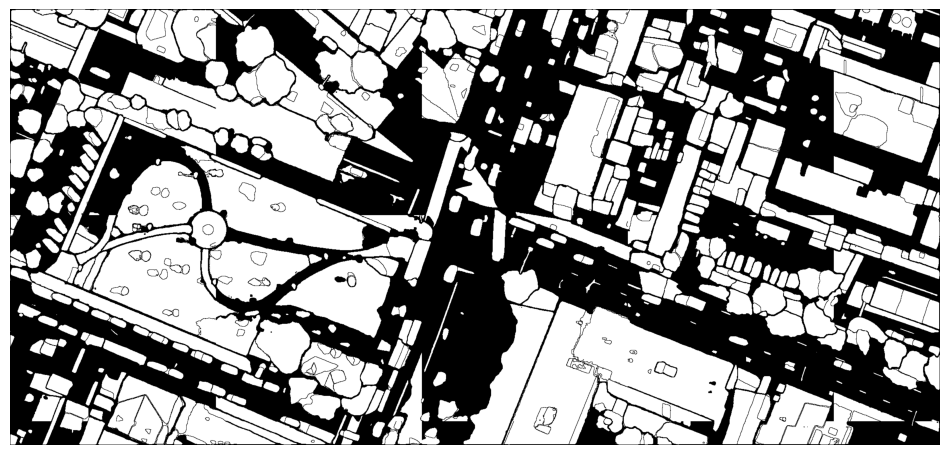

In [7]:
sam.show_masks(cmap='binary_r')